In [1]:
include("math405.jl")

 Activating environment at `~/Documents/UBC/Math/Math 405/math405_2020W/assignments/A4/Project.toml`


## Applications of the Lax Wendroff Scheme

### Outline
Usages of Lax-Wendroff
1. Linear Advection/One-way Wave Equation in one spatial dimension
2. Other conservation laws

Compare stability and accuracy of Lax-Wendroff with the upwind scheme discussed in class. 

#### Linear Advection/Wave Equation
$$ 
    u_t + a u_x = 0
$$
Discretize to solve as follows
$$
    \frac{U_n^{m+1} - U_n^m}{\tau}
    = 
    - a \frac{U_{n+1}^m - U_{n-1}^m}{2 h}
    + \frac{\tau a^2}{2} \frac{U_{n+1}^m - 2 U_n^m + U_{n-1}^m}{h^2}
$$
Rearrange to get 
$$
    U_n^{m+1} = \left( 1 - \frac{\tau^2a^2}{h^2} \right)\,\,U_n^m + \left( \frac{\tau^2a^2}{2h^2} - \frac{\tau a}{2h} \right)\,\,U_{n+1}^m + \left( \frac{\tau^2a^2}{2h^2} + \frac{\tau a}{2h} \right)\,\,U_{n-1}^m
$$

### Motivation

Lets look at a simple IVP for this case.
$$
    u_0(x) = \sin(2\pi x)
$$ 
With the exact solution
$$
    u(x, t) = \sin(2\pi(x - at))
$$ 

In [225]:
a = 1
N = 20; h = 1/N; X = range(h, 1, length=N); xp = range(0, 1, length=1000)
Id = sparse(I, (N, N)); D⁻ = (Id - circshift(Id, 1)) / h
τ = 0.1*h 
#u0 = x -> 1/(1+exp(-100 * (x - 0.2))) * 1/(1+exp(100 * (x - 0.6)))
u0 = x -> (sin(x*(2*pi)))
U = u0.(X);

┌ Info: Saved animation to 
│   fn = /Users/owensheekey/Documents/UBC/Math/Math 405/math405_2020W/assignments/A4/tmp.gif
└ @ Plots /Users/owensheekey/.julia/packages/Plots/shY1Z/src/animation.jl:104


Plots.AnimatedGif("/Users/owensheekey/Documents/UBC/Math/Math 405/math405_2020W/assignments/A4/tmp.gif")
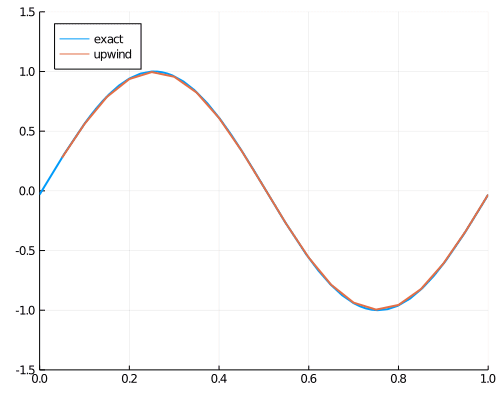

In [226]:
@gif for m = 1:350
    U -= τ * (D⁻ * U)
    plot(x -> u0(x-a*m*τ), 0, 1, lw=2, size = (500, 400), xlims = (0, 1), ylims = (-1.5, 1.5), label = "exact", legend = :topleft)
    plot!(X, U, lw=2, label = "upwind")
end

#### What happens when we apply the Lax Wendroff?

In [227]:
U_lw = u0.(X);
U = u0.(X);
Id = sparse(I, (N, N))
Id⁻ = sparse(I, (N, N)) .* (τ^2 * a^2)/(h^2)
L⁺ = circshift(Id, 1) .* ((τ^2 * a^2)/(2*h^2) + (a*τ)/(2*h))
R⁻ = circshift(Id, -1) .* (a*τ)/(2*h)
R⁺ = circshift(Id, -1) .* (τ^2 * a^2)/(2*h^2);

┌ Info: Saved animation to 
│   fn = /tmp/anim.gif
└ @ Plots /Users/owensheekey/.julia/packages/Plots/shY1Z/src/animation.jl:104


Plots.AnimatedGif("/tmp/anim.gif")
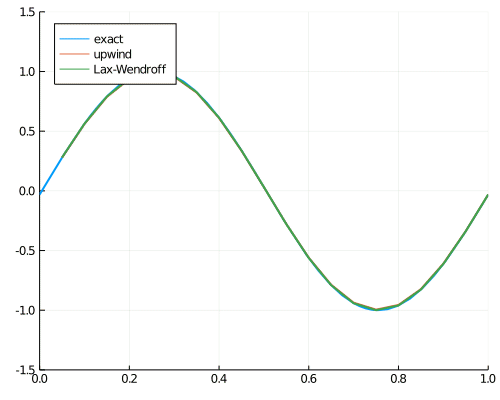

In [228]:
anim = @animate for m = 1:350
    U -= τ * (D⁻ * U)
    U_lw = ((Id - Id⁻) + L⁺ + (R⁺ - R⁻)) * U_lw
    plot(x -> u0(x-m*τ), 0, 1, lw=2, size = (500, 400), xlims = (0, 1), ylims = (-1.5, 1.5), label = "exact", legend = :topleft)
    plot!(X, U, lw=2, label = "upwind")
    plot!(X, U_lw, lw=2, label = "Lax-Wendroff")
end
gif(anim, "/tmp/anim.gif", fps = 15)

#### What happens when we make $a$ negative?

In class, we showed that the upwind amplifies when given a wave going in the reverse direction$^1$. How does Lax-Wendroff do?
&nbsp;

&nbsp;

&nbsp;

&nbsp;

&nbsp;

$^1$ *Here we only consider the case of upwind as downwind produces the analogous characteristics and centered finite differences is useless.*

In [229]:
a = -1;

In [230]:
U_lw = u0.(X);
U = u0.(X);
Id = sparse(I, (N, N))
Id⁻ = sparse(I, (N, N)) .* (τ^2 * a^2)/(h^2)
L⁺ = circshift(Id, 1) .* ((τ^2 * a^2)/(2*h^2) + (a*τ)/(2*h))
R⁻ = circshift(Id, -1) .* (a*τ)/(2*h)
R⁺ = circshift(Id, -1) .* (τ^2 * a^2)/(2*h^2);

┌ Info: Saved animation to 
│   fn = /tmp/anim.gif
└ @ Plots /Users/owensheekey/.julia/packages/Plots/shY1Z/src/animation.jl:104


Plots.AnimatedGif("/tmp/anim.gif")
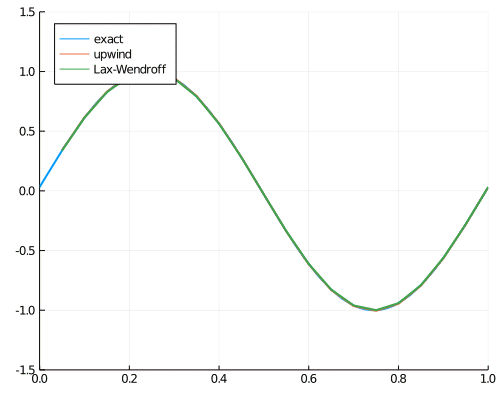

In [231]:
anim = @animate for m = 1:350
    U -= a*τ * (D⁻ * U)
    U_lw = ((Id - Id⁻) + L⁺ + (R⁺ - R⁻)) * U_lw
    plot(x -> u0(x-a*m*τ), 0, 1, lw=2, size = (500, 400), xlims = (0, 1), ylims = (-1.5, 1.5), label = "exact", legend = :topleft)
    plot!(X, U, lw=2, label = "upwind")
    plot!(X, U_lw, lw=2, label = "Lax-Wendroff")
end
gif(anim, "/tmp/anim.gif", fps = 15)

So the upwind scheme is growing but the Lax-Wendroff scheme is still matching the exact solution well.

### Stability and accuracy
There is a critical parameter
$$
    \frac{a\tau}{h} 
$$
*(hopefully already derived?)* that can help see what is happening.

In [238]:
function UErratT(τfac, t, a, N)
    h = 1/N
    X = range(h, 1, length=N)
    
    τ = τfac*h 
    U_lw = u0.(X);
    U = u0.(X);
    Id = sparse(I, (N, N))
    Id⁻ = sparse(I, (N, N)) .* (τ^2 * a^2)/(h^2)
    L⁺ = circshift(Id, 1) .* ((τ^2 * a^2)/(2*h^2) + (a*τ)/(2*h))
    R⁻ = circshift(Id, -1) .* (a*τ)/(2*h)
    R⁺ = circshift(Id, -1) .* (τ^2 * a^2)/(2*h^2);

    for m = 1:trunc(t/τ)
        U -= a*τ * (D⁻ * U)
        U_lw = ((Id - Id⁻) + L⁺ + (R⁺ - R⁻)) * U_lw
    end
    
    return U, U_lw, [u0(x-a*(trunc(t/τ)*τ)) for x = X]
end

UErratT (generic function with 1 method)

In [239]:
up_err = []
lw_err = []
τfac_vals = []
for i = -6:0.2:1
    τfac = 10^i
    U_up, U_lw, U_sol = UErratT(τfac, 1, 1, 20)
    append!(up_err, norm(U_up - U_sol))
    append!(lw_err, norm(U_lw - U_sol))
    append!(τfac_vals, τfac)
end

##### Just like upwind and other explicit finite difference techniques for advection problems, Lax-Wendroff is stable for $a\tau/h < 1$

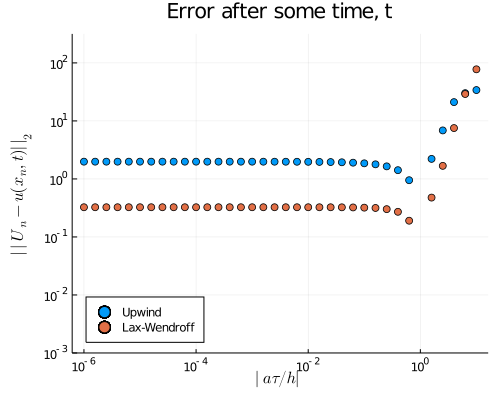

In [255]:
plot(τfac_vals, up_err, xaxis=:log, yaxis=:log, size = (500, 400), label = "Upwind", legend = :bottomleft,seriestype = :scatter)
plot!(τfac_vals, lw_err, xaxis=:log, yaxis=:log, label = "Lax-Wendroff", seriestype = :scatter, ylims = (10^(-3), 10^2.5))
xlabel!(L"\|a\tau/h\|")
ylabel!(L"\|\| U_n - u(x_n, t) \|\|_2")
title!("Error after some time, t")

*The value $ a\tau/h$ is also sometimes referred to as the Courant number.*

We could talk about the weirdness that happens at $10^0$. To show that, delete `ylims` on line 2. It can be shown exactly why this happens using spectral analysis, but basically you get a really good approximation when $a\tau/h = (a\tau/h)^2$.

We have now talked about solving the  **Linear Advection/Wave Equation**, using Lax-Wendroff

## Advantages
1. 2nd order accuracy when $a\tau/h$ is small.
2. Compatible with positive _or_ negative value of $a$ (wave going in either direction) without becoming unstable.

We will not discuss it here but similar techniques can be applied to **Nonlinear Advection/Wave Equations**  including schemes like Richtmyer, two-step Lax-Wendroff, and MacCormack.

#### Higher dimensions and a more interesting problem
In general, we can use Lax Wendroff to solve many conservation laws! And in more than one spatial dimension. Lets look at solving something like$^2$
$$
    u_t +  \nabla \mathbf{a} u = 0
$$

&nbsp;

&nbsp;

&nbsp;

&nbsp;

&nbsp;


$^2$ This is a most general form of conservation laws in Physics. For example, let $u$ be charge density and $a$ be velocity of charges and you end up with conservation of charge.

#### With this general conservation form, we can begin looking at more than one spatial dimension.

For example, consider IVP w/ $u_0 = e^{-r^2}$, $\mathbf{a} = (0, -1)$

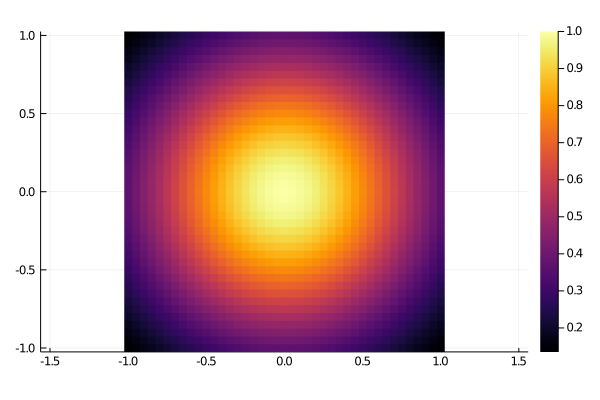

In [258]:
h = 0.05
u0 = (x,y) -> exp(-(x^2 + y^2))
X = -1:0.05:1
Y = -1:0.05:1
N=length(X)
z0 = zeros(N,N)
for i = 1:N
    for j = 1:N
        z0[i,j] = u0(X[i], Y[j])
    end
end
heatmap(X, Y, z0, aspect_ratio = 1)

In [250]:
a = -10
τ = 0.01*h 
Id = sparse(I, (N, N))
Id⁻ = sparse(I, (N, N)) .* (τ^2 * a^2)/(h^2)
L⁺ = circshift(Id, 1) .* ((τ^2 * a^2)/(2*h^2) + (a*τ)/(2*h))
R⁻ = circshift(Id, -1) .* (a*τ)/(2*h)
R⁺ = circshift(Id, -1) .* (τ^2 * a^2)/(2*h^2);

┌ Info: Saved animation to 
│   fn = /tmp/anim.gif
└ @ Plots /Users/owensheekey/.julia/packages/Plots/shY1Z/src/animation.jl:104


Plots.AnimatedGif("/tmp/anim.gif")
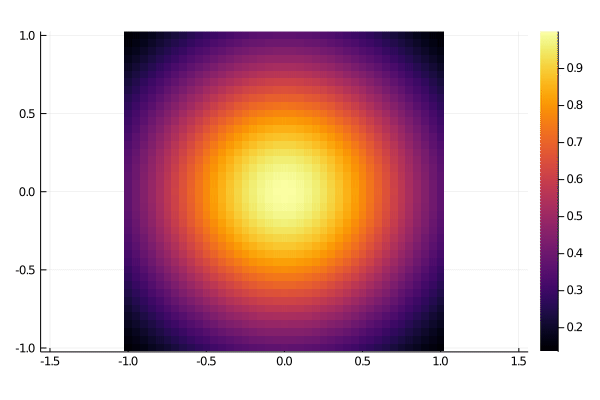

In [256]:
z = z0
anim = @animate for m = 1:400
    z = ((Id - Id⁻) + L⁺ + (R⁺ - R⁻)) * z
    heatmap(X, Y, z, aspect_ratio = 1)
    title!()
end
gif(anim, "/tmp/anim.gif", fps = 15)

#### Solving a fluid dynamics problem
In fluid dynamics, this conservation equation can be restated as
$$
    \frac{\partial \rho}{\partial t} + \nabla \cdot (\rho \mathbf{v}) = 0
$$
Where $\rho$ is the density, and $\mathbf{v}$ is the flow vector at a given point.

Let's look at an example where we a flow vector,  $\mathbf{v}$ , which is a function of $x$ and $y$.

$$\begin{align}
&u_0 = \sin(2\pi xy)   &\mathbf{v} = (e^{-|x|}, 0)
\end{align}$$

In [324]:
h = 0.05
u0 = (x,y) -> sin(2*pi*x*y)
X = -2:0.05:2
Y = -2:0.05:2
N=length(X)
z0 = zeros(N,N)
for i = 1:N
    for j = 1:N
        z0[i,j] = u0(X[i], Y[j])
    end
end


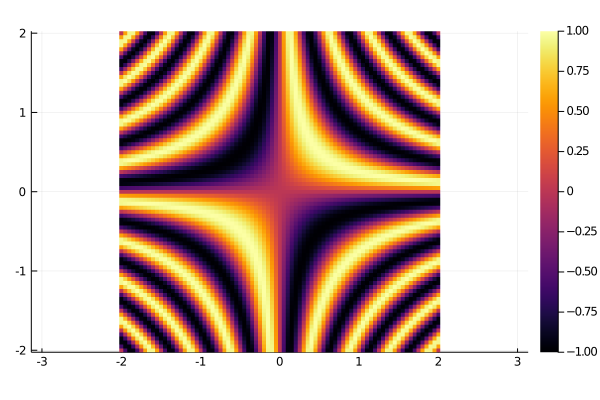

In [325]:
heatmap(X, Y, z0, aspect_ratio = 1)

In [326]:
τ = 0.01*h 
Id = sparse(I, (N, N))
Id⁻ = sparse(I, (N, N)) .* (τ^2)/(h^2)
L⁺ = circshift(Id, 1) .* (τ^2)/(2*h^2)
L⁺⁺ = circshift(Id, 1) .* (τ)/(2*h)
R⁻ = circshift(Id, -1) .* (τ)/(2*h)
R⁺ = circshift(Id, -1) .* (τ^2)/(2*h^2);

┌ Info: Saved animation to 
│   fn = /tmp/anim.gif
└ @ Plots /Users/owensheekey/.julia/packages/Plots/shY1Z/src/animation.jl:104


Plots.AnimatedGif("/tmp/anim.gif")
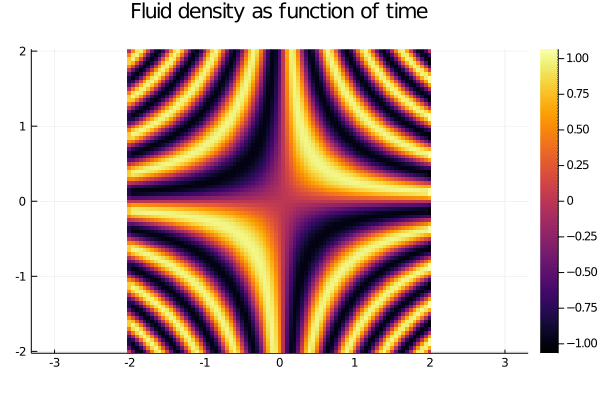

In [328]:
z = z0
anim = @animate for m = 1:400
    a = 100*diagm([exp(-abs(y)) for y = Y])
    asqr = a * a
    z_temp = ((Id - asqr*Id⁻) + asqr*L⁺ + a*L⁺⁺ + (asqr*R⁺ - a*R⁻)) * z'
    z = z_temp'
    heatmap(X, Y, z, aspect_ratio = 1)
    title!("Fluid density as function of time")
end
gif(anim, "/tmp/anim.gif", fps = 15)
